## Advanced Lane Finding Project (only for Images)

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
#libraries:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import pickle
import matplotlib.image as mpimg

%matplotlib qt
%matplotlib inline

# 1. Camera Calibration
To start, we have to calibrate the camera by deleting the distortion because of lens form. To recognize the distorsion of the lenses, we take pictures of a chess board from different points of view. Then, each picture (nodes) are analyzed and a **matrix** is computed. This matrix would undistort any picture taken with this camera.

### 1.1 Read Picture and Extract Node Position

I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful chessboard detection.  

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
node_x =  9  # intern nodes on chess picture in x direction
node_y =  6
objp = np.zeros((node_x*node_y,3), np.float32)
objp[:,:2] = np.mgrid[0:node_x, 0:node_y].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (node_x,node_y), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (node_x,node_y), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

### 1.2 Get and Save Matrix, and Testing of the matrix

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function. I applied this distortion correction to the test image using the `cv2.undistort()` function. Also, the undistort matrix and distortion coefficient are save on `dist_pickle`, to be use on any picture taken by the same camera.

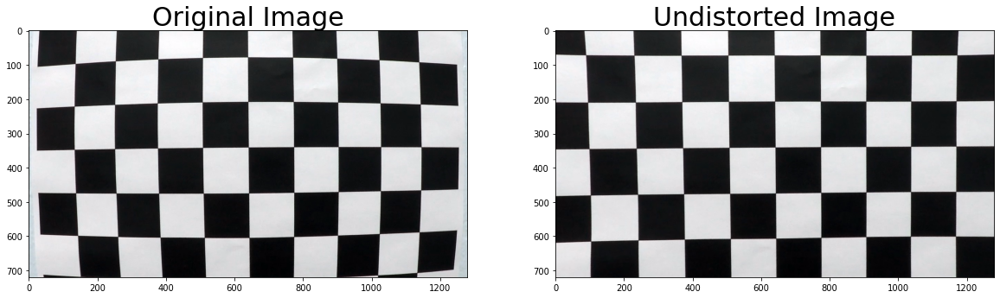

In [3]:
import pickle
%matplotlib inline

# Test undistortion on an image
img_chess = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img_chess.shape[1], img_chess.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None) # mtrx is the conversion matrix!

dst = cv2.undistort(img_chess, mtx, dist, None, mtx)
cv2.imwrite('output_images/calibration1_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img_chess)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)
f.savefig('output_images/plot_undistort_output.jpg')

# 2. Distort Correction on Raws Images
using the matrix and distance computed before, I will undistort all pictures

### 2.1. Test on one Raw Image

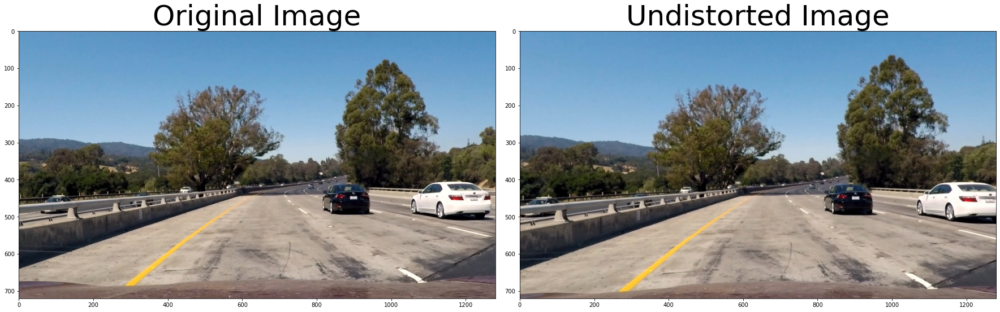

In [4]:
# Read in the saved camera matrix and distortion coefficients
dist_pickle = pickle.load( open( "wide_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

# Read in an image
img = mpimg.imread('test_images/test1.jpg')

# function, which undistort picture (take out calibration error from pictures)
def cal_undistort(img, mtx, dist):
    #ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1:], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

undistorted = cal_undistort(img, mtx, dist)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undistorted)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 2.2. Transforming all pictures and saving them

In [5]:
import os
# Make a list raw images
images_raw = glob.glob('test_images/*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_raw):
    img_raw = mpimg.imread(fname)
    img_undist = cal_undistort(img_raw, mtx, dist)

    dirname = os.path.basename(fname)
    dirname = os.path.splitext(dirname)[0]
    mpimg.imsave('output_images/undist_'+ dirname +'.jpg',img_undist)   

# 3. Thresholded binary image

## 3.1. Analyze of best Layers

### 3.1.1. Which is the best Layer on RGB?  ---> R is here the best layer

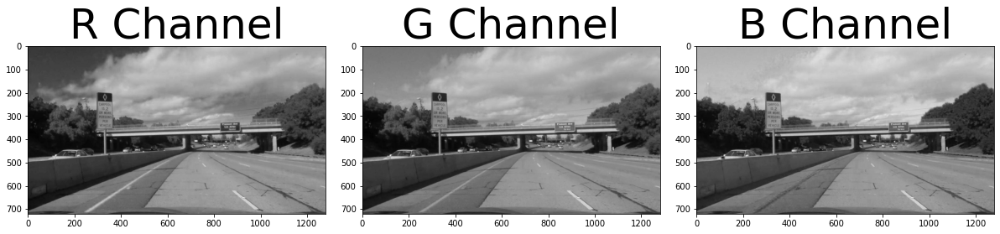

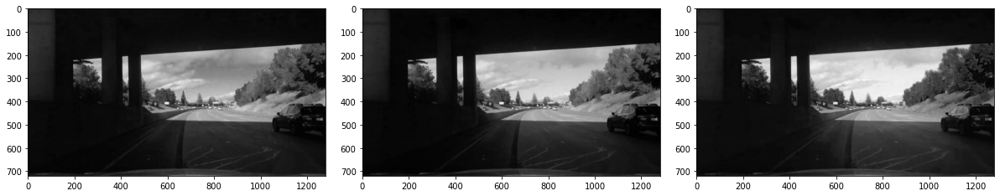

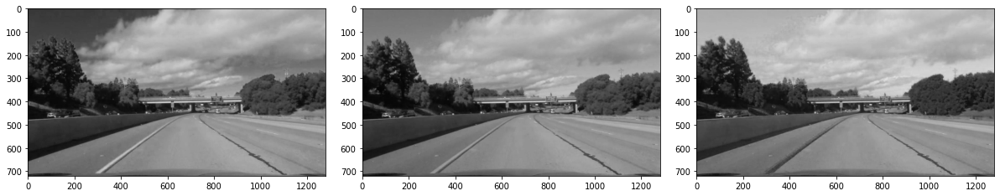

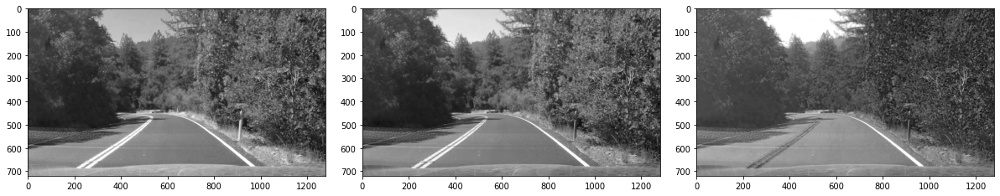

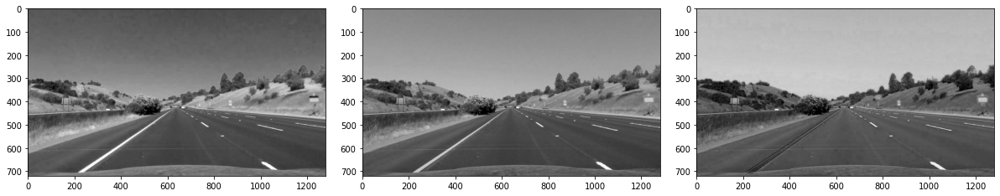

...

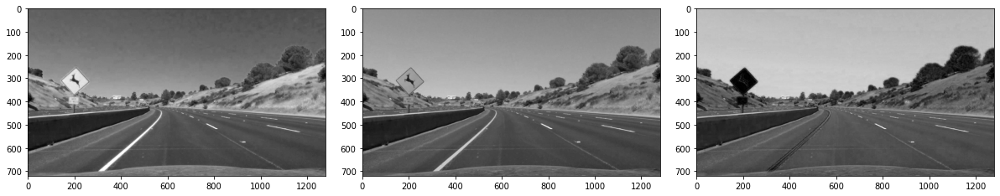

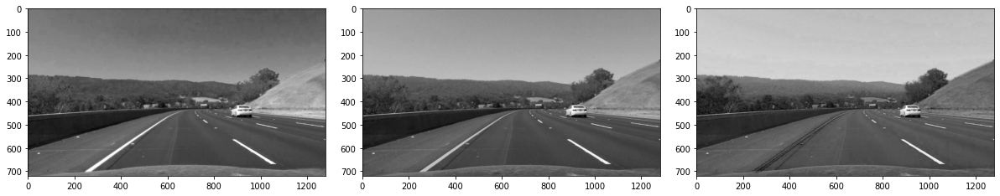

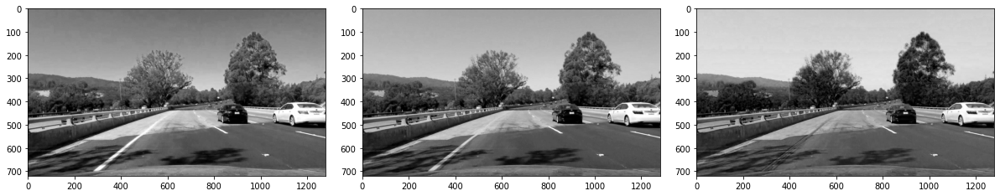

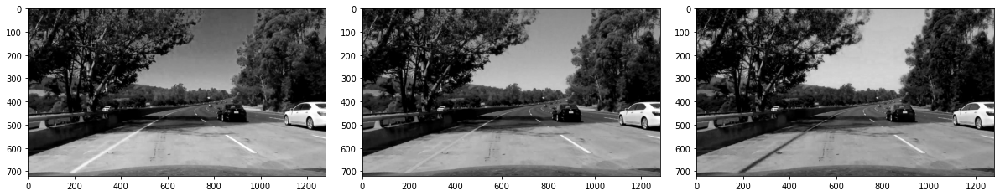

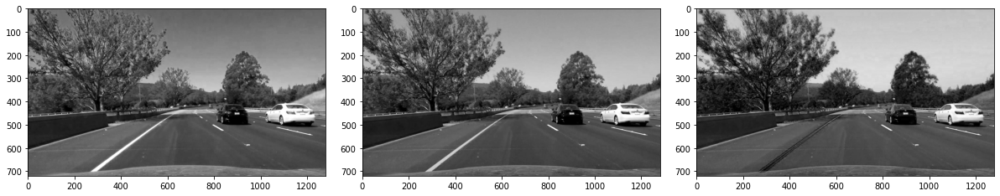

In [6]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    R_channel = img[:,:,0]
    G_channel = img[:,:,1]
    B_channel = img[:,:,2]
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(R_channel, cmap='gray')
        ax1.set_title('R Channel', fontsize=50)
        ax2.imshow(G_channel, cmap='gray')
        ax2.set_title('G Channel', fontsize=50)
        ax3.imshow(B_channel, cmap='gray')
        ax3.set_title('B Channel', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(R_channel, cmap='gray')
        ax2.imshow(G_channel, cmap='gray')
        ax3.imshow(B_channel, cmap='gray')
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        

**Result:** Red is the best RGB Layer in all pictures, because it shows the road line whiter

### 3.1.2. Which is the best Layer on HLS? ---> S is here the best layer

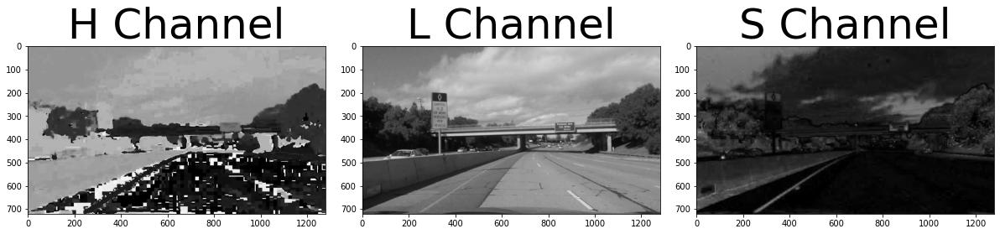

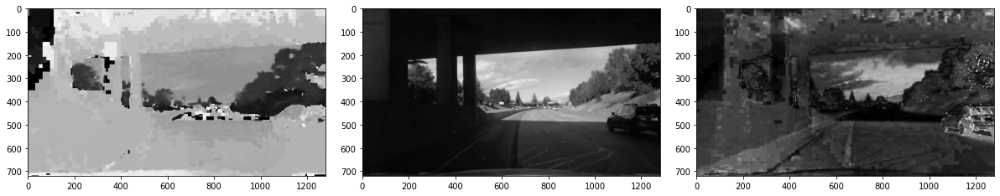

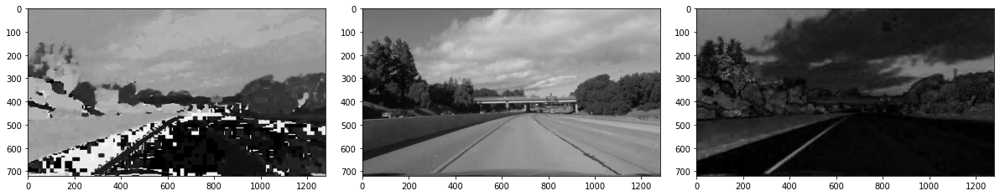

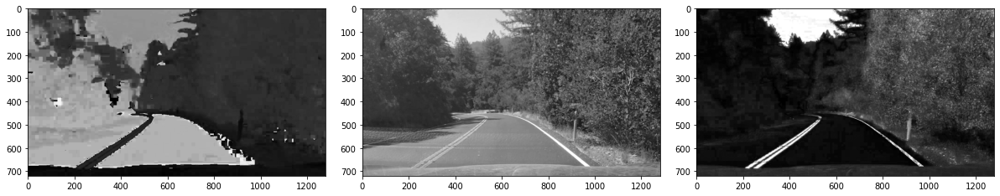

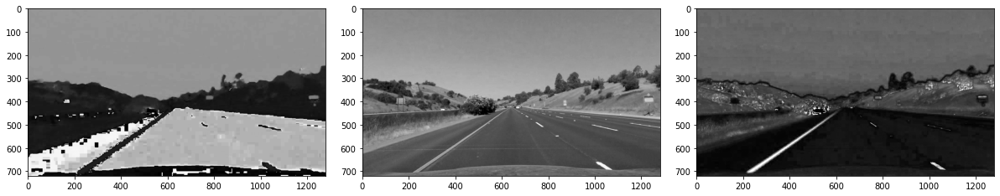

...

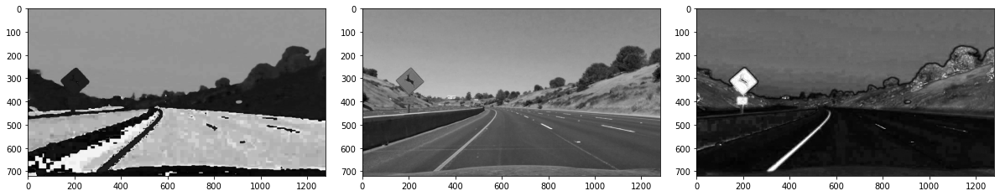

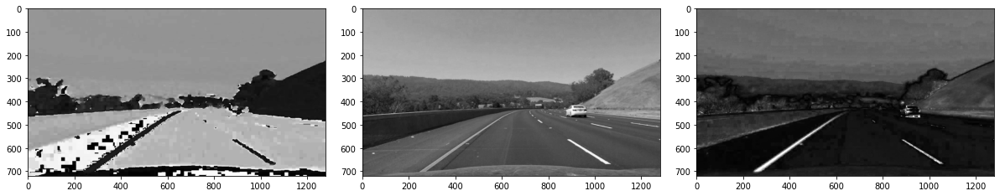

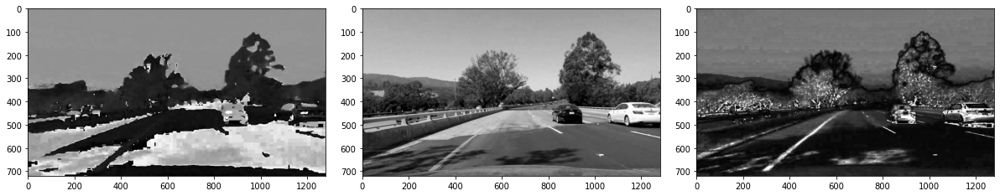

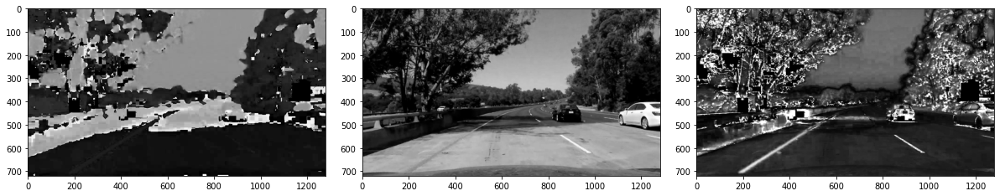

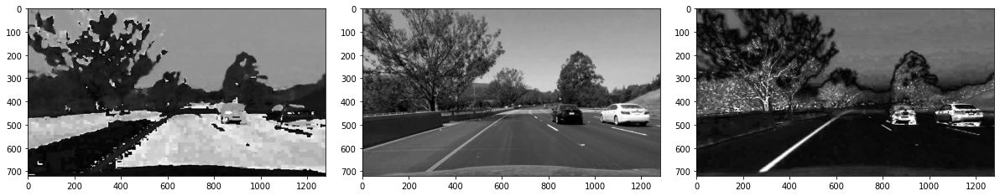

In [7]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(h_channel, cmap='gray')
        ax1.set_title('H Channel', fontsize=50)
        ax2.imshow(l_channel, cmap='gray')
        ax2.set_title('L Channel', fontsize=50)
        ax3.imshow(s_channel, cmap='gray')
        ax3.set_title('S Channel', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(h_channel, cmap='gray')
        ax2.imshow(l_channel, cmap='gray')
        ax3.imshow(s_channel, cmap='gray')
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        

**Result:** S ist the best layer when lighting is too much. However, L is better for stripped and small lines, for example: future lines

### 3.1.3. Which is the best Layer on HSV?---> V is here the best layer

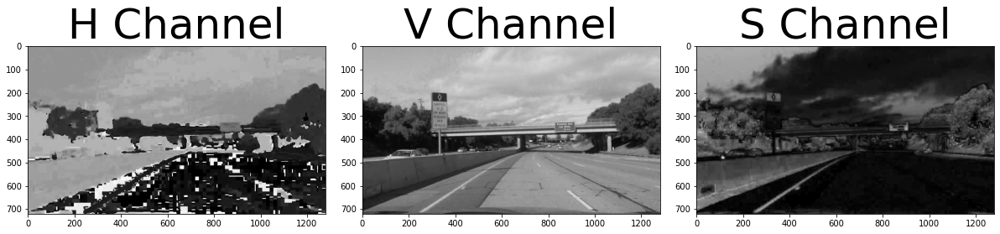

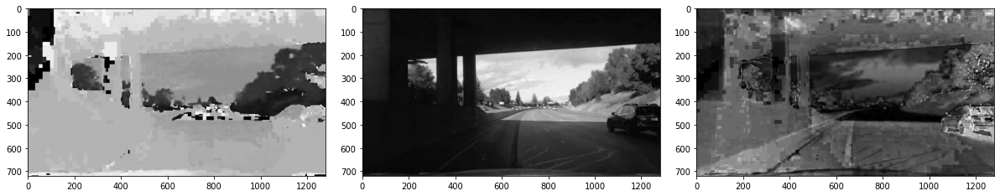

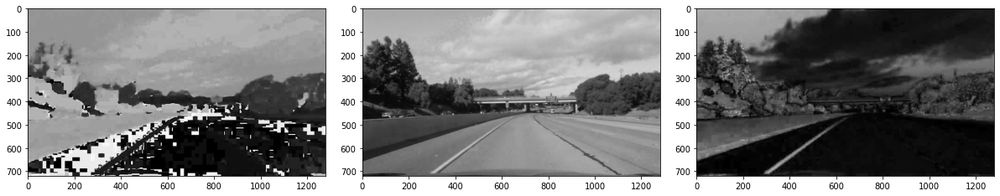

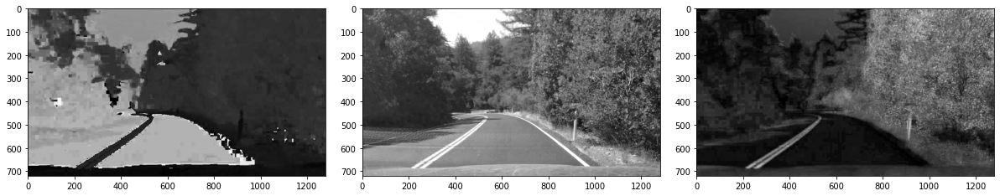

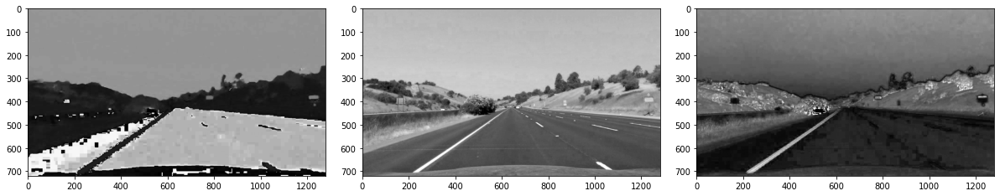

...

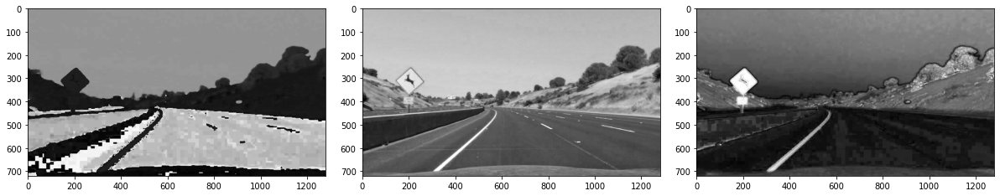

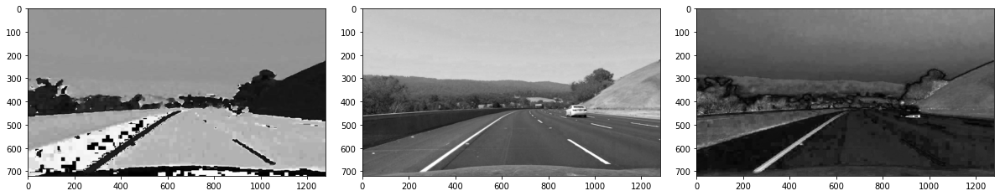

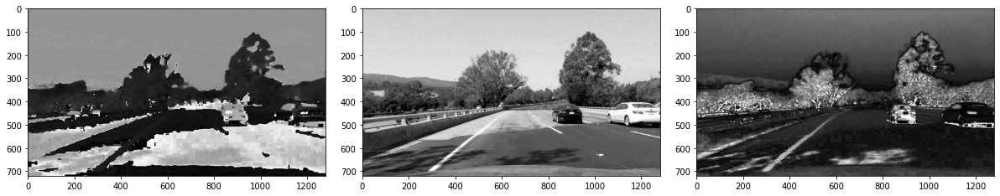

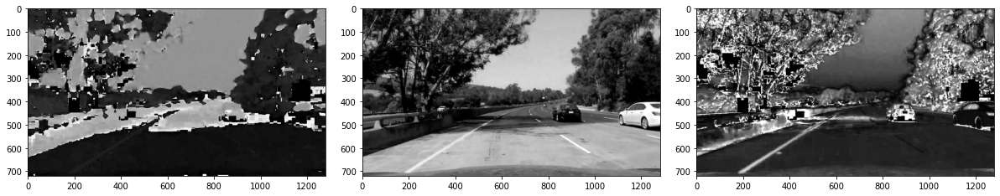

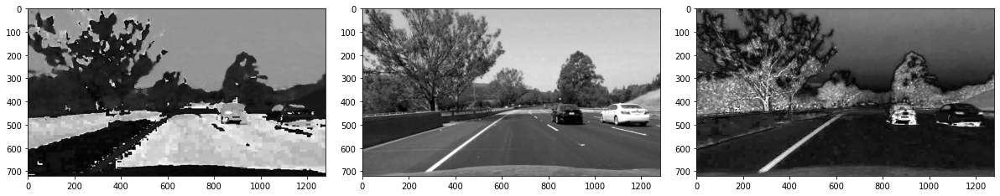

In [8]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    
    hvs = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    h_channel = hvs[:,:,0]
    v_channel = hvs[:,:,2]
    s_channel = hvs[:,:,1]
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(h_channel, cmap='gray')
        ax1.set_title('H Channel', fontsize=50)
        ax2.imshow(v_channel, cmap='gray')
        ax2.set_title('V Channel', fontsize=50)
        ax3.imshow(s_channel, cmap='gray')
        ax3.set_title('S Channel', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(h_channel, cmap='gray')
        ax2.imshow(v_channel, cmap='gray')
        ax3.imshow(s_channel, cmap='gray')
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

**Result:** V Channel is the best layer here

### **Result:** S is the best layer. 

### 3.1.4. Which is the second best layer? (R vs L vs V) --> searching for the best chanell for small lines

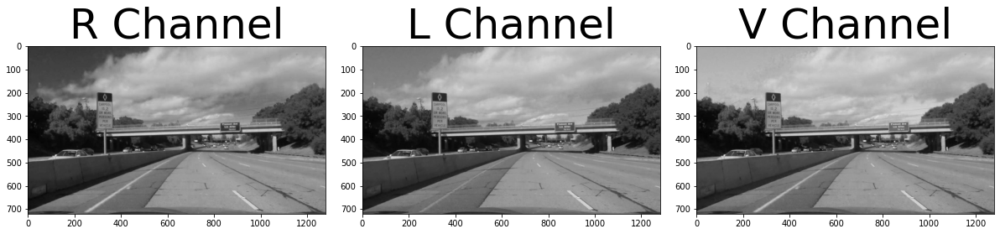

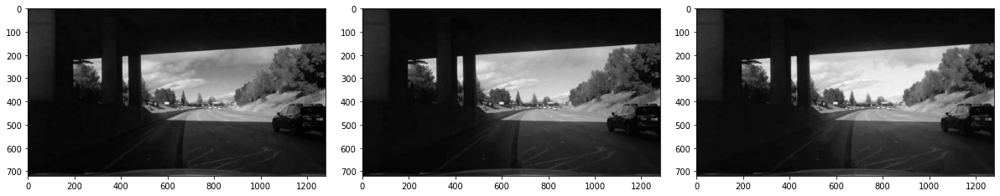

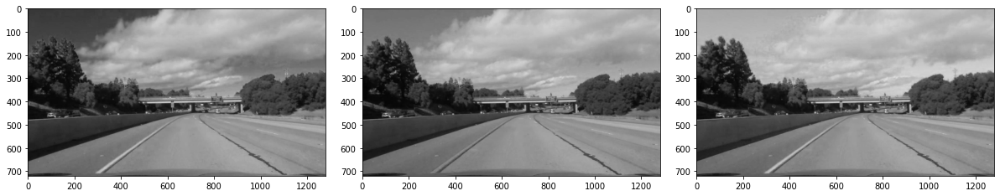

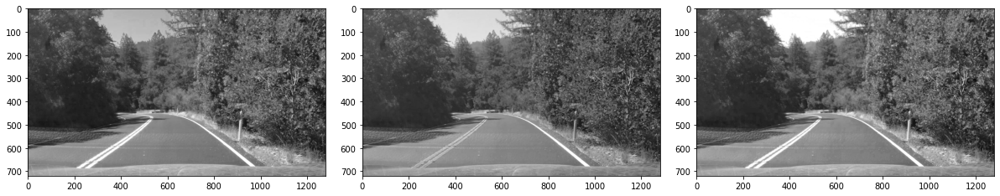

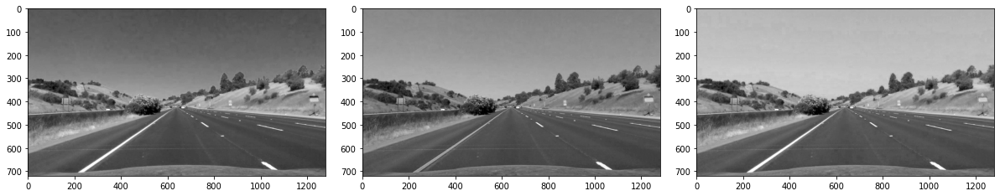

...

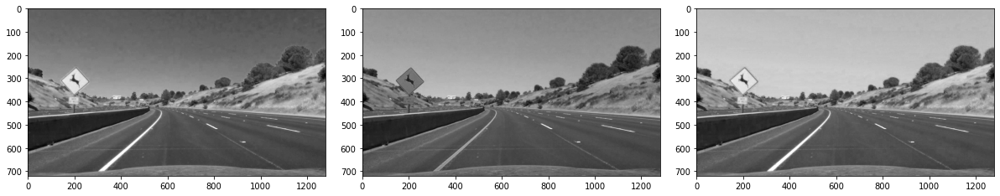

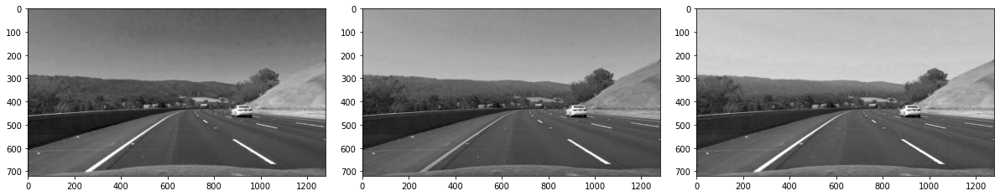

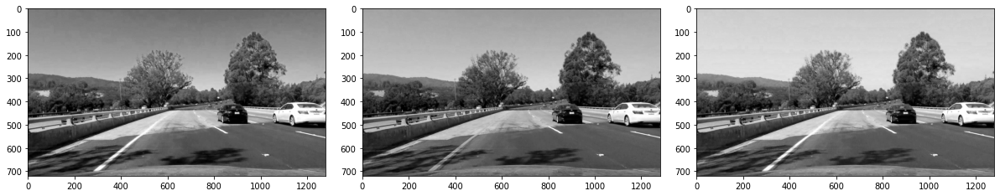

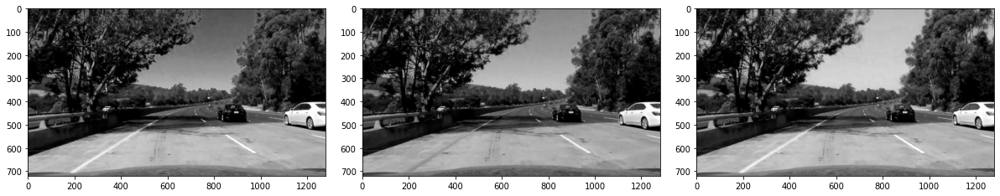

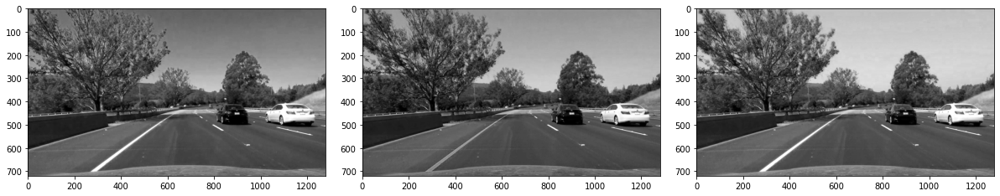

In [9]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    R_channel = img[:,:,0]
    #G_channel = img[:,:,1]
    #B_channel = img[:,:,2]
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    #h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    #s_channel = hls[:,:,2]
    hvs = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    #h_channel = hvs[:,:,0]
    v_channel = hvs[:,:,2]
    #s_channel = hvs[:,:,1]
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(R_channel, cmap='gray')
        ax1.set_title('R Channel', fontsize=50)
        ax2.imshow(l_channel, cmap='gray')
        ax2.set_title('L Channel', fontsize=50)
        ax3.imshow(v_channel, cmap='gray')
        ax3.set_title('V Channel', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(R_channel, cmap='gray')
        ax2.imshow(l_channel, cmap='gray')
        ax3.imshow(v_channel, cmap='gray')
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

**Result:** R is the best line. R > V >> L
### **Result:** R is the second best layer.

## 3.2. Threshold Tunning
### 3.2.1. Sorbel X with threshold (with R Channel)
R-Channel is used for Sorbel X. After that a normalization to 255 is done. Then, relevant threshold is applied.

In [10]:
def R_sobelx(img, sx_thresh=(30, 100)):
    
    # Get R Layer
    R_channel = img[:,:,0]
    #R_channel[(R_channel <= 50)] = 255  <-- not a good option, because Sorbel would recognized line here
    
    # Sobel x, using R_channel
    sobelx = cv2.Sobel(R_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    return sxbinary

For `harder_challenge` video, there are many trees nearby the road, which are not filtered for the R-channel or Sobel Threshold. Because of that, I use the green color of H-Channel and subtract green pixels from image result.

In [11]:
def RH_sobelx(img, sx_thresh=(30, 100), sh_thresh = (28,90)):
    
    # Get R Layer
    R_channel = img[:,:,0]
    #R_channel[(R_channel <= 50)] = 255  <-- not a good option, because Sorbel would recognized line here
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H_channel = hls[:,:,0]
    
    # Sobel x, using R_channel
    sobelx = cv2.Sobel(R_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    #threshold H channel
    sxbinary[(H_channel <= sh_thresh[1]) & (H_channel >= sh_thresh[0])] = 0
    
    return sxbinary

#sxbinary = R_sobel(image_undist, sx_thresh=(10,255))

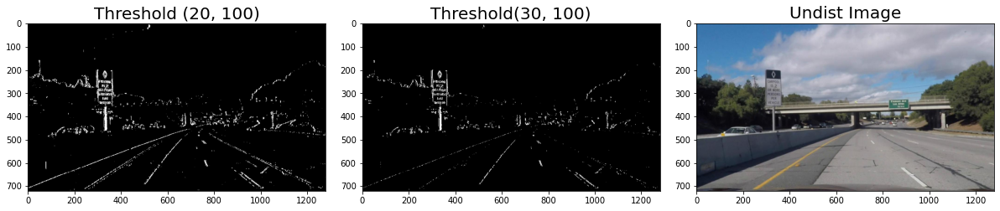

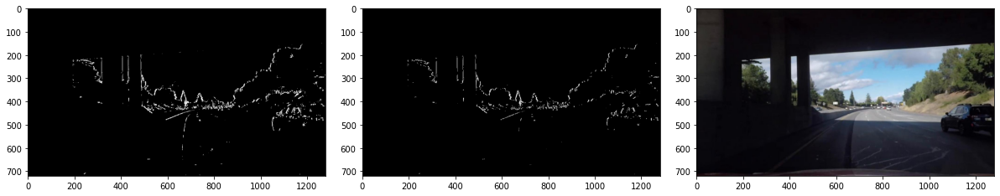

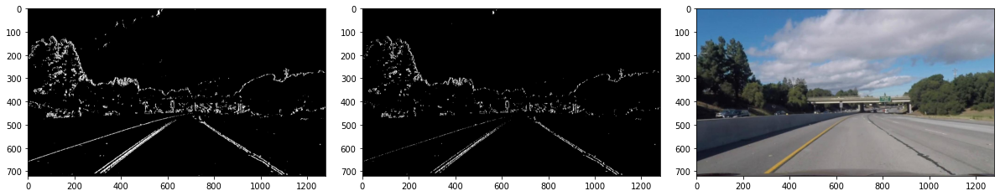

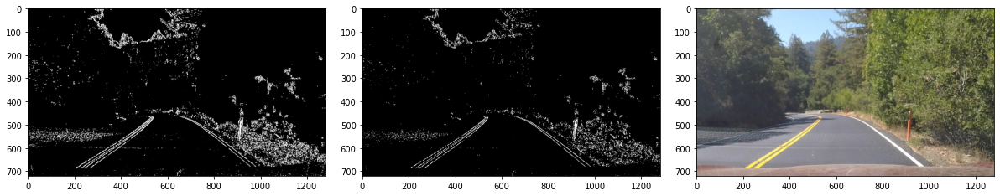

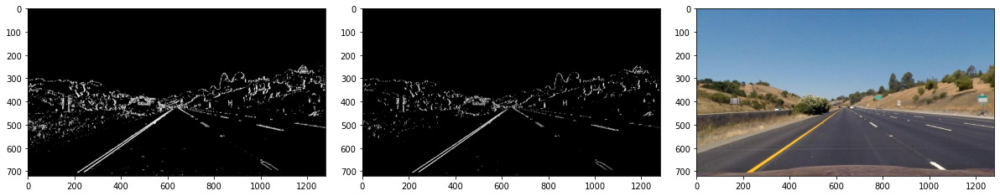

...

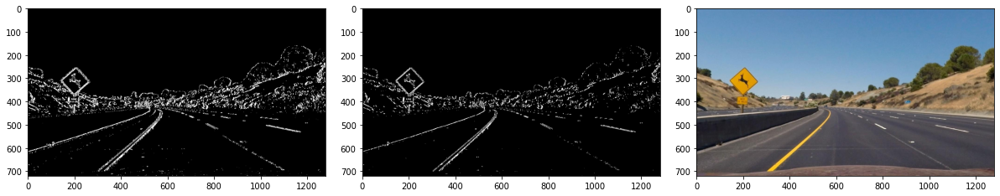

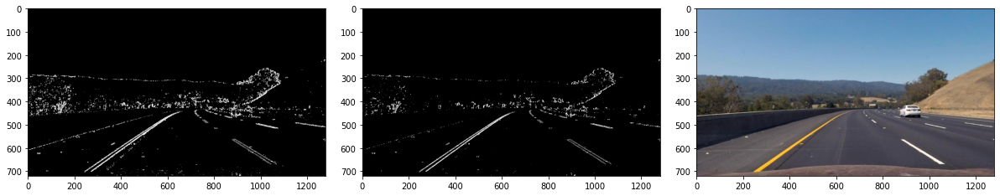

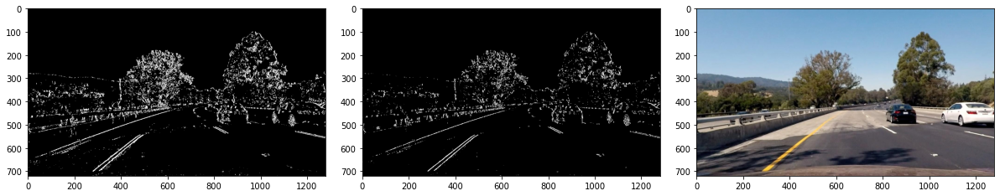

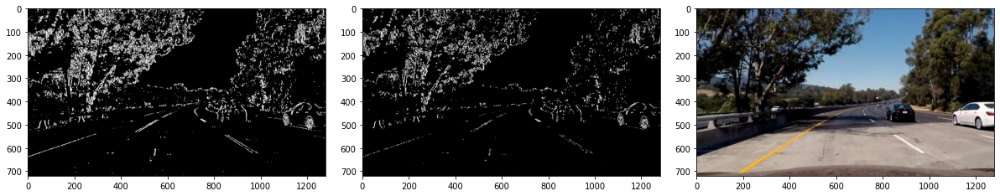

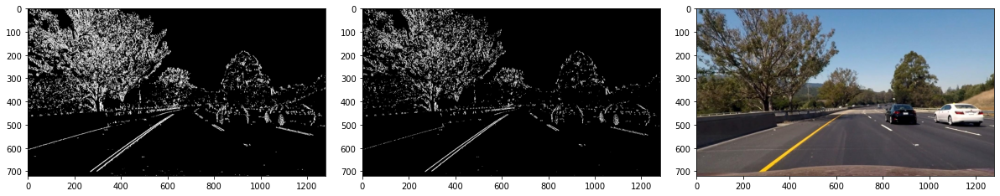

In [12]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    
    sx_thresh1 = (20,100)
    sx_thresh2 = (30,100)
    #sx_thresh3 = (30,255)
    
    sxbinary1 = RH_sobelx(img, sx_thresh=sx_thresh1)
    sxbinary2 = RH_sobelx(img, sx_thresh=sx_thresh2)
    #sxbinary3 = R_sobelx(img, sx_thresh=sx_thresh3)
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(sxbinary1, cmap='gray')
        ax1.set_title('Threshold ' + str(sx_thresh1), fontsize=20)
        ax2.imshow(sxbinary2, cmap='gray')
        ax2.set_title('Threshold' + str(sx_thresh2), fontsize=20)
        ax3.imshow(img, cmap='gray')
        ax3.set_title('Undist Image', fontsize=20)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(sxbinary1, cmap='gray')
        ax2.imshow(sxbinary2, cmap='gray')
        ax3.imshow(img)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

**sx_thresh_min:** 
30 is too much, it delete some real road lines.
10 is too less, to much noise is present on the pictures.

**sx_thresh_max:** 
100 is enough

### 3.2.2. S-Channel with combined Threshold
I tried two approaches:

One is only S-Channel with threshold. By tunning, I realized that it is a compromise between seeing road lines and dont seeing shadows (which would cause false fitted lines).

In [13]:
def S_thresholded(img, s_thresh=(150, 255)):
    # Threshold color channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    # Threshold S Channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    return s_binary

Second is the S-channel with threshold + R threshold. To be able to increase the threshold min, shadows have to be erase of the picture. Shadows and also breaks are dark pixels on R-Channel. When a pixel on R-Channel is under **sr_thresh**, it would result on 0, even though it would pass the S-Threshold. 

In [14]:
def SR_thresholded(img, s_thresh=(90, 255), sr_thresh = 30):
    # Threshold color channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    
    # Threshold S Channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Removing Pixels from S Channel using R Channel 
    R_channel = img[:,:,0]
    s_binary[(R_channel <= sr_thresh)] = 0
    
    return s_binary

I would compare both approaches. 

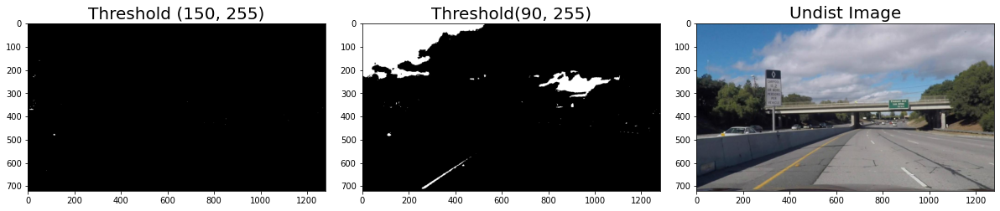

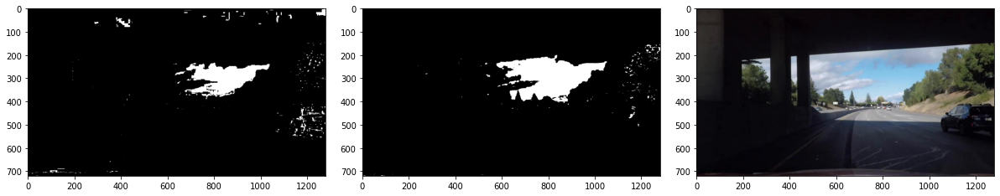

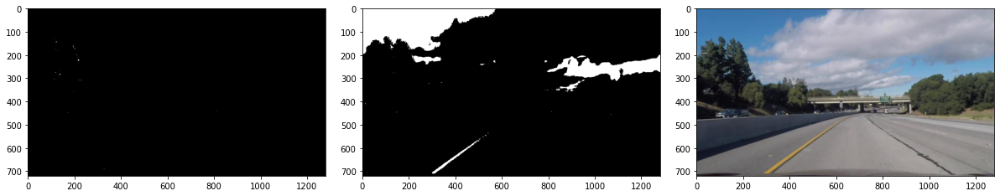

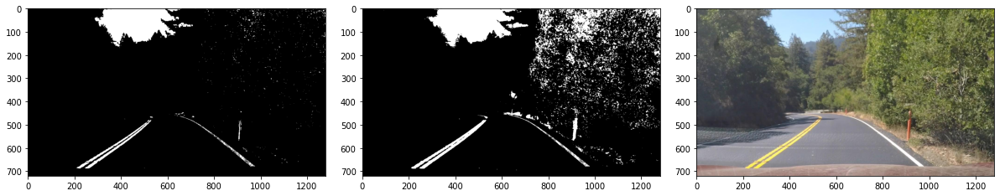

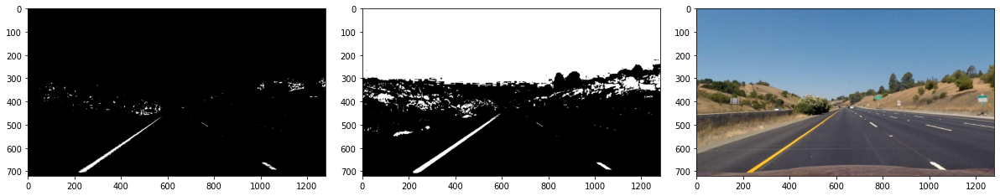

...

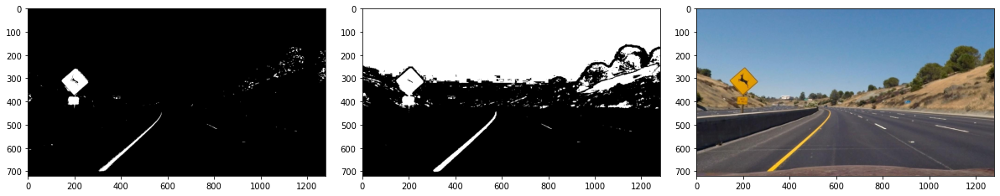

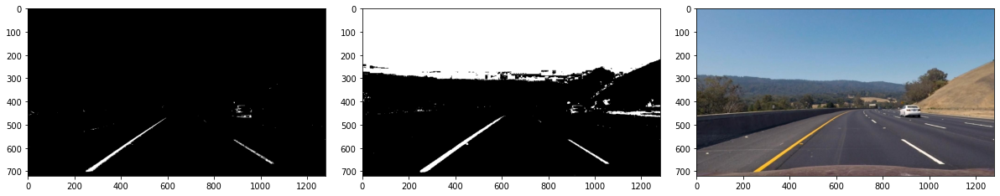

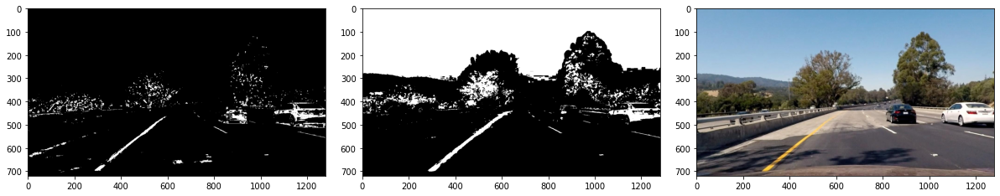

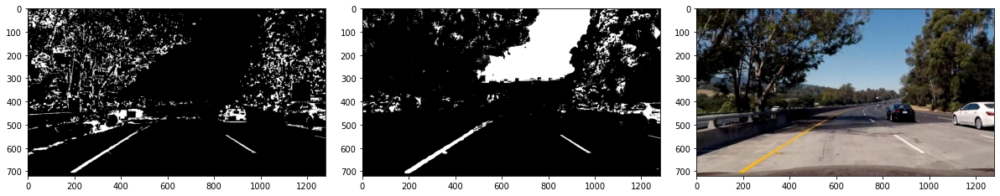

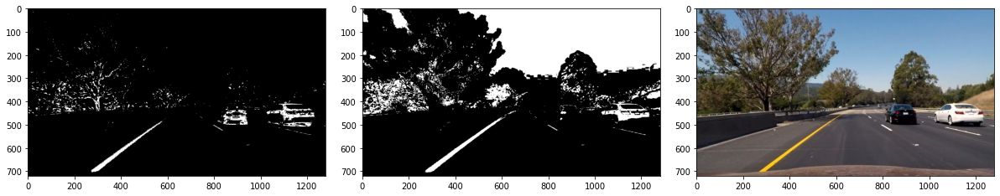

In [15]:
# Make a list raw images
images_undist = glob.glob('output_images/undist_*.jpg')

# Step through the list and undistort all images
for idx, fname in enumerate(images_undist):
    img = mpimg.imread(fname)
    
    s_thresh1 = (150,255) 
    s_thresh2 = (90,255) #140
    #sx_thresh3 = (30,255)
    
    sbinary1 = S_thresholded(img, s_thresh=s_thresh1)
    sbinary2 = SR_thresholded(img, s_thresh=s_thresh2)
    
    if idx ==0:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(sbinary1, cmap='gray')
        ax1.set_title('Threshold ' + str(s_thresh1), fontsize=20)
        ax2.imshow(sbinary2, cmap='gray')
        ax2.set_title('Threshold' + str(s_thresh2), fontsize=20)
        ax3.imshow(img, cmap='gray')
        ax3.set_title('Undist Image', fontsize=20)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    else:
        f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16, 7))
        f.tight_layout()
        ax1.imshow(sbinary1, cmap='gray')
        ax2.imshow(sbinary2, cmap='gray')
        ax3.imshow(img)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

SR_thresholded is better on these test images. On the background, there is relevant information not filtered, but it would be cutted con the view transformation.

## 3.3 Final Threshold Binary Function

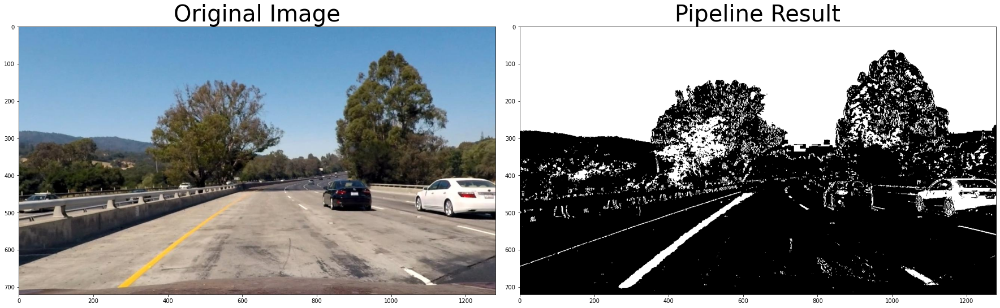

In [16]:
image_undist = mpimg.imread('output_images/undist_test1.jpg')

# Edit this function to create your own pipeline.
def pipeline(img, s_thresh=(90, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
  
    sxbinary = R_sobelx(img, sx_thresh=sx_thresh)
    s_binary = SR_thresholded(img, s_thresh=s_thresh)
       
    # Stack each channel
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary)) * 255
    img_binary =  np.zeros_like(s_binary)
    #color_binary[(s_binary>0) | (sxbinary>0)] = 1
    img_binary = np.bitwise_or(s_binary,sxbinary)
    
    return img_binary
    
img_binary = pipeline(image_undist, sx_thresh=(30,100))  #(20,100)

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()

ax1.imshow(image_undist)
ax1.set_title('Original Image', fontsize=40)

ax2.imshow(img_binary, cmap='gray')
ax2.set_title('Pipeline Result', fontsize=40)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

f.savefig('output_images/plot_binary_output1.jpg')

# 4. Birds-eye view Transform

### 4.1. Search Points in Straight Lines

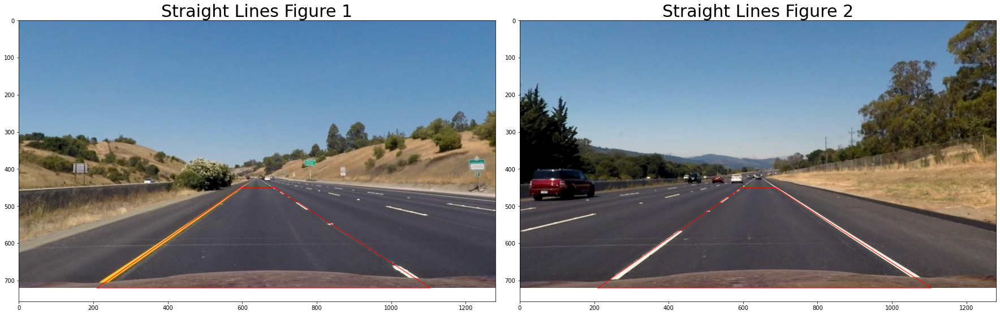

In [17]:
image_straight = mpimg.imread('output_images/undist_straight_lines1.jpg')
image_straight2 = mpimg.imread('output_images/undist_straight_lines2.jpg')

img_size = (image_straight.shape[1], image_straight.shape[0])
# Define the 4 Points of the Trapezoid
left_bottom = [210, img_size[1]]     #[201]
right_bottom = [1105, img_size[1]]
left_top = [595, 450]    #[598, 450]
right_top = [687, 450]   

# define the point only for plotting
x = [left_bottom[0], right_bottom[0], right_top[0], left_top[0], left_bottom[0]]
y = [left_bottom[1], right_bottom[1], right_top[1], left_top[1], left_bottom[1]]

# define the point only for plotting
offset = 300
x_warped = [offset, img_size[0]-offset, img_size[0]-offset, offset, offset]
y_warped = [0, 0, img_size[1], img_size[1],0]

# Display the image and show region and color selections
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image_straight)
ax1.plot(x, y, 'r', lw=1)
ax1.set_title('Straight Lines Figure 1', fontsize=30)
ax2.imshow(image_straight2)
ax2.set_title('Straight Lines Figure 2', fontsize=30)
ax2.plot(x, y, 'r', lw=1)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

### 4.2. Transformation Function

In [18]:
def bird_eye_view(img):
    # Select area
    img_size= (img.shape[1], img.shape[0])
    # 4 Points of the Trapezoid
    left_bottom = [210, img_size[1]]     #[201]
    right_bottom = [1105, img_size[1]]
    left_top = [595, 450]    #[598, 450]
    right_top = [687, 450]  
    # 4 source points src = np.float32([[,],[,],[,],[,]])
    src= np.float32([left_top, right_top, right_bottom, left_bottom])
    # 4 destination points dst = np.float32([[,],[,],[,],[,]])
    offset = 300
    dst = np.float32([[offset, 0], [img_size[0]-offset, 0],[img_size[0]-offset, img_size[1]],[offset, img_size[1]]])
    # get M, the transform matrix
    M= cv2.getPerspectiveTransform(src, dst)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M

### 4.3. Testing the Transformation Function

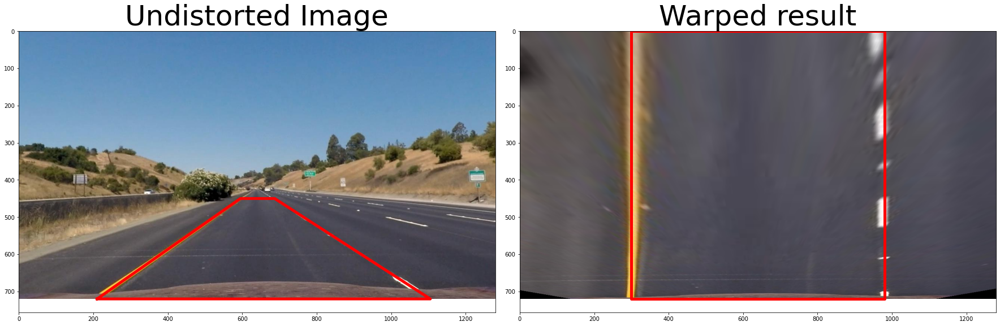

In [19]:
top_down, perspective_M = bird_eye_view(image_straight)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image_straight)
ax1.set_title('Undistorted Image', fontsize=50)
ax1.plot(x, y, 'r', lw=5)
ax2.imshow(top_down)
ax2.set_title('Warped result', fontsize=50)
ax2.plot(x_warped, y_warped, 'r', lw=5)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
f.savefig('output_images/plot_warped_output.jpg')

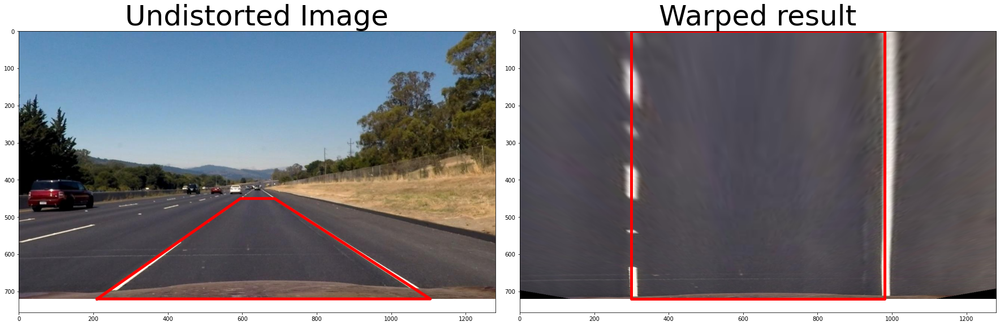

In [20]:
top_down, perspective_M = bird_eye_view(image_straight2)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image_straight2)
ax1.set_title('Undistorted Image', fontsize=50)
ax1.plot(x, y, 'r', lw=5)
ax2.imshow(top_down)
ax2.set_title('Warped result', fontsize=50)
ax2.plot(x_warped, y_warped, 'r', lw=5)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
f.savefig('output_images/plot_warped_output2.jpg')

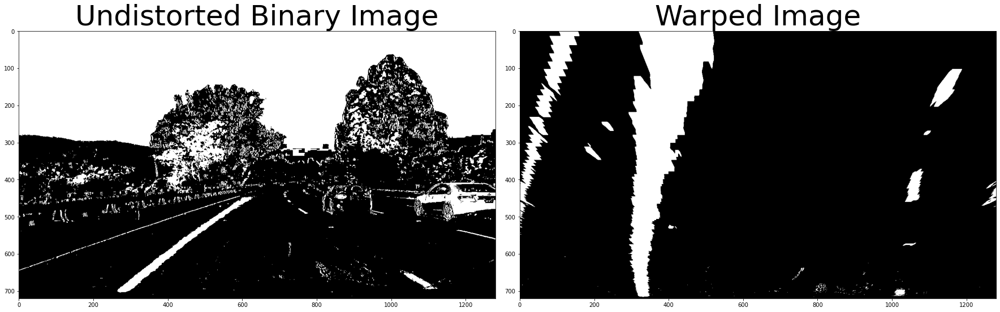

In [21]:
binary_warped, perspective_M = bird_eye_view(img_binary)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img_binary, cmap='gray')
ax1.set_title('Undistorted Binary Image', fontsize=50)
ax2.imshow(binary_warped, cmap='gray')
ax2.set_title('Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# 5. Detect the lane pixels

In [22]:
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])

### 5.1 Complex Line Detection
The image is divided by the half, and the histogram is calculated. The maximum value of each histogram should represent the start of the line. Then, the line will be searched in pieces.

This should be done  for:
- on first frame
- when after many frame, no plausible line is found

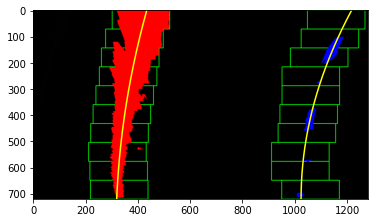

In [23]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))#*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 10 #9
    # Set the width of the windows +/- margin
    margin = 110 #100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img, left_fit, right_fit

#left_fit is [A,B,C]
out_img, left_fit, right_fit = fit_polynomial(binary_warped)

plt.imshow(out_img)

**left_fit** and **right_fit** are the polynomial coefficients a,b and c from ay^2+by+c = x

**left_fit_x** and **right_fit_x** are the list with line points in x axis. **ploty** is the list in y axis

In [24]:
print(left_fit)

[ 1.63285054e-04 -2.76594438e-01  4.33771550e+02]


### 5.2. Search from Prior 
Knowing where the line was before, it would search for valid pixels nearby and compute the new line.

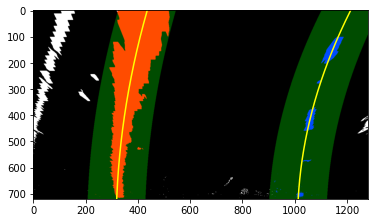

In [25]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty, left_fit, right_fit

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 110 #100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ##
    #   --> it generates a binary image with 1 on the interest region. 
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions  --> index list
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty, left_fit, right_fit = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)  #return zeros array with the same shape
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))]) # vstack=Stack arrays in sequence vertically (row wise).
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))]) #numpy.flipud = Flip array in the up/down direction.
    left_line_pts = np.hstack((left_line_window1, left_line_window2)) #np.hstack=Stack arrays in sequence horizontally (column wise).
    #array should draw the perimeter to fill later. ([x1 y1],[x2 y2])
    
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    # cv2.fillPoly expects [[[ [375   0] .... [575   0] ]]]
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##
    
    return result, left_fit, right_fit, left_fitx, right_fitx

# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
result, left_fit, right_fit, left_fitx, right_fitx = search_around_poly(binary_warped, left_fit, right_fit)

# View your output
plt.imshow(result)

# 6. Back onto the original image with visual output
Transformed the line from warped image into undistorted view. Then combine this line with original undistort image

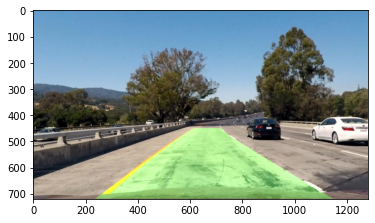

In [26]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

#Before #top_down, perspective_M = bird_eye_view(image_straight2)
Minv = np.linalg.inv(perspective_M)
# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (image_undist.shape[1], image_undist.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(image_undist, 1, newwarp, 0.3, 0)
plt.imshow(result)

# 7. Determine the Curvature and Vehicle position
### 7.1. Common Variables

In [27]:
img_size = (binary_warped.shape[1], binary_warped.shape[0])
offset = 300
xm_per_pix = 3.7/(img_size[0]-2*offset) # meters per pixel in x dimension 3.7/700  30/680

### 7.2. Curvature Calculation

In [28]:
def measure_curvature_real():
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 50/img_size[1] # meters per pixel in y dimension 15/720 30/720  30/720
    #xm_per_pix = 3.7/(img_size[0]-2*offset) # meters per pixel in x dimension 3.7/700  30/680
     
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # then the polynom coefficient are convert into meteres using xm_per_axis and ym_per_axis
    left_fit_cr = [(left_fit[0]*xm_per_pix) / (ym_per_pix**2), (xm_per_pix/ym_per_pix)*left_fit[1], left_fit[2]]
    right_fit_cr = [(right_fit[0]*xm_per_pix) / (ym_per_pix**2), (xm_per_pix/ym_per_pix)*right_fit[1], right_fit[2]]
    
    ##### using the coefficient in meters, the real curvature is calculated
    left_curverad = ((1+(left_fit_cr[0]*2*y_eval+left_fit_cr[1])**2)**(1.5))/(np.abs(2*left_fit_cr[0]))
    right_curverad = ((1+(right_fit_cr[0]*2*y_eval+right_fit_cr[1])**2)**(1.5))/(np.abs(2*right_fit_cr[0]))
    return left_curverad, right_curverad

# Calculate the radius of curvature in meters for both lane lines
left_curverad, right_curverad = measure_curvature_real()

curverad = int((left_curverad + right_curverad)/2)

print(left_curverad, 'm', right_curverad, 'm')

2862.6015984532314 m 1909.5457481696117 m


### 7.3 Determine vehicle position
with position to the center. Assumption: the camera is positionated in the center of the car.

In [29]:
center_car = img_size[0]/2

#get initial points of the line
# Point Format: np.array([[[0, 0]]], dtype=np.float32)
point_warped_right = np.float32([[[right_fitx[-1], img_size[1]]]])
point_warped_left = np.float32([[[left_fitx[-1], img_size[1]]]])
#convert this point to original undistort view
point_unwarped_right = cv2.perspectiveTransform(point_warped_right, Minv)[0][0][0]
point_unwarped_left = cv2.perspectiveTransform(point_warped_left, Minv)[0][0][0]
#calcualte position of the car
center_road = (point_unwarped_right - point_unwarped_left)/2 + point_unwarped_left
position= round((center_car - center_road)*xm_per_pix,2)

In [30]:
print(position)

-0.28


# 10. Display radius and vehicle position

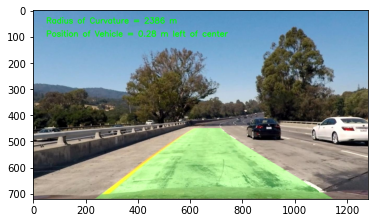

In [31]:
cv2.putText(result, text='Radius of Curvature = ' + str(curverad) + ' m', org=(50,50),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,255,0),
            thickness=2, lineType=cv2.LINE_AA)
if position > 0:
    cv2.putText(result, text='Position of Vehicle = ' + str(abs(position)) + ' right of center', org=(50,100),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,255,0),
            thickness=2, lineType=cv2.LINE_AA)
elif position < 0:
    cv2.putText(result, text='Position of Vehicle = ' + str(abs(position)) + ' m left of center', org=(50,100),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,255,0),
            thickness=2, lineType=cv2.LINE_AA)
else:
    cv2.putText(result, text='Vehicle is on the middle!', org=(50,100),
            fontFace= cv2.FONT_HERSHEY_SIMPLEX, fontScale=1, color=(0,255,0),
            thickness=2, lineType=cv2.LINE_AA)

plt.imshow(result)

# 11. Pipeline (Video)
see P2-Videos.ipynb

## Sanity_check:
This function check the plausibility of the fitted line (see P2-Videos.ipynb)

## Video results:
Video result in folder ./output_videos


Here 's a link to my video result.
[![](./output_images/result1.jpg)](./output_videos/project_video_output_F1.mp4 "Video")

Here 's a link to my video tunning result
[![](./output_images/tunning1.jpg)](./output_videos/project_video_output_4view.mp4 "Video")

Here 's a link to my video tunning result for challenge video
[![](./output_images/tunning_challenge_1.jpg)](./output_videos/challenge_video_output_4view.mp4 "Video")

Here 's a link to my video tunning result for harder challenge video. Here is the pipeline nicht enough and bigger adjustment should be done.
[![](./output_images/tunning_hchallenge_1.jpg)](./output_videos/hchallenge_video_output_4view1.mp4 "Video")



### Discussion

#### 1. Briefly discuss any problems / issues you faced in your implementation of this project.  

Where will your pipeline likely fail?  
- unclean windown or reflection on the window
- by wrong region of interest (amrgin window not enough by search_polynom): 
    - when curvature of the road ist too sharp
    - goes from right to left in the same frame,
    - when road goes up or down
- dry leaves or similar in yellow color near by the roads

What could you do to make it more robust?
- Different decision if too much pixels are detected. If two many are detected as line:
    - it should mean that something nearby is considered as a line --> Sharp Threshold
    - If there are too few pixels, line is hide because of light condition --> Broad Threshold
- Extra conditions if curvature is too high
- Expand the polynom to search also for S-curves
- Compute a middle curve and use it for sanity-check